# Set Up

In [1]:
from __future__ import annotations

import anndata as ad
import decoupler
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn.objects as so
import session_info
import sys

sys.path.insert(0, '/home/workspace/')
from utilities import *

hdir = '/home/workspace'
wdir = hdir + "/mm_bm_chip_organoids/EXP-01244"
objdir = wdir + "/processing/objects/"

wk2_adata = sc.read_h5ad(objdir + "wk2_adata.h5ad")
wk3_adata = sc.read_h5ad(objdir + "wk3_adata.h5ad")
wk4_adata = sc.read_h5ad(objdir + "wk4_adata.h5ad")
ds_full_adata = sc.read_h5ad(objdir + "ds_all_samples_adata.h5ad")
no_ds_full_adata = sc.read_h5ad(objdir + "not_ds_all_samples_adata.h5ad")

adatas = [wk2_adata, wk3_adata, wk4_adata, ds_full_adata, no_ds_full_adata]

sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=200)
sc.set_figure_params(figsize=(4, 4))

/home/workspace/environment/mm_py_env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/workspace/environment/mm_py_env/lib/python3.9/site-packages/scanpy/_settings.py:488: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


# Single Cell Best Practices: Gene set enrichment and pathway analysis

In [2]:
# Filtering warnings from current version of matplotlib
import warnings

warnings.filterwarnings(
    "ignore", message=".*Parameters 'cmap' will be ignored.*", category=UserWarning
)
warnings.filterwarnings(
    "ignore", message="Tight layout not applied.*", category=UserWarning
)

In [3]:
import os
os.environ['PATH'] = '/home/workspace/environment/mm_py_env/bin:' + os.environ['PATH']
os.environ['R_HOME'] = '/home/workspace/environment/mm_py_env/lib/R'

import anndata2ri
get_ipython().run_line_magic('load_ext', 'rpy2.ipython')
anndata2ri.activate()

cffi mode is CFFI_MODE.ANY
R home found: /home/workspace/environment/mm_py_env/lib/R
R library path: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
Default options to initialize R: rpy2, --quiet, --no-save
R is already initialized. No need to initialize.
/tmp/ipykernel_8197/532566060.py:7: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [ ]:
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

celltype_condition = '0'

# extract scores
t_stats = (
    # Get dataframe of DE results for condition vs. rest
    sc.get.rank_genes_groups_df(adata, celltype_condition, key='t-test')
    # Subset to highly variable genes
    .set_index("names")
    .loc[adata.var["highly_variable"]]
    # Sort by absolute score
    .sort_values("scores", key=np.abs, ascending=False)[
        # Format for decoupler
        ["scores"]
    ]
    .rename_axis([celltype_condition], axis=1)
)

t_stats

In [ ]:
# Downloading reactome pathways
from pathlib import Path

if not Path("c2.cp.reactome.v7.5.1.symbols.gmt").is_file():
    !wget -O 'c2.cp.reactome.v7.5.1.symbols.gmt' https://figshare.com/ndownloader/files/35233771

In [ ]:
def gmt_to_decoupler(pth: Path) -> pd.DataFrame:
    """Parse a gmt file to a decoupler pathway dataframe."""
    from itertools import chain, repeat

    pathways = {}

    with Path(pth).open("r") as f:
        for line in f:
            name, _, *genes = line.strip().split("\t")
            pathways[name] = genes

    return pd.DataFrame.from_records(
        chain.from_iterable(zip(repeat(k), v) for k, v in pathways.items()),
        columns=["geneset", "genesymbol"],
    )

In [ ]:
reactome = gmt_to_decoupler("c2.cp.reactome.v7.5.1.symbols.gmt")

In [ ]:
# Retrieving via python
msigdb = decoupler.get_resource("MSigDB")

# Get reactome pathways
reactome = msigdb.query("collection == 'reactome_pathways'")
# Filter duplicates
reactome = reactome[~reactome.duplicated(("geneset", "genesymbol"))]

In [ ]:
reactome

In [ ]:
# Filtering genesets to match behaviour of fgsea
geneset_size = reactome.groupby("geneset").size()
gsea_genesets = geneset_size.index[(geneset_size > 15) & (geneset_size < 500)]

In [ ]:
scores, norm, pvals = decoupler.run_gsea(
    t_stats.T,
    reactome[reactome["geneset"].isin(gsea_genesets)],
    source="geneset",
    target="genesymbol",
)

gsea_results = (
    pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
    .droplevel(level=1, axis=1)
    .sort_values("pval")
)

In [ ]:
(
    so.Plot(
        data=(
            gsea_results.head(20).assign(
                **{"-log10(pval)": lambda x: -np.log10(x["pval"])}
            )
        ),
        x="-log10(pval)",
        y="source",
    ).add(so.Bar())
)

In [ ]:
gsea_results.sort_values(by='norm').head(10)

In [ ]:
%%time
decoupler.run_aucell(
    adata,
    reactome,
    source="geneset",
    target="genesymbol",
    use_raw=False,
)

In [ ]:
ifn_pathways = [
    "REACTOME_LAMININ_INTERACTIONS",
    "REACTOME_INTERLEUKIN_10_SIGNALING",
    "REACTOME_SARS_COV_2_ACTIVATES_MODULATES_INNATE_AND_ADAPTIVE_IMMUNE_RESPONSES"
]

adata.obs[ifn_pathways] = adata.obsm["aucell_estimate"][ifn_pathways]

sc.pl.umap(
    adata,
    color=["leiden"] + ifn_pathways,
    frameon=False,
    ncols=2,
    wspace=0.3,
    vmax='p99'
)

# REACTOME Pathways

Loading Reactome Pathways 2024 gene sets...


0005 gene_sets have been filtered out when max_size=2000 and min_size=0


Using 2100 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Analysis complete!


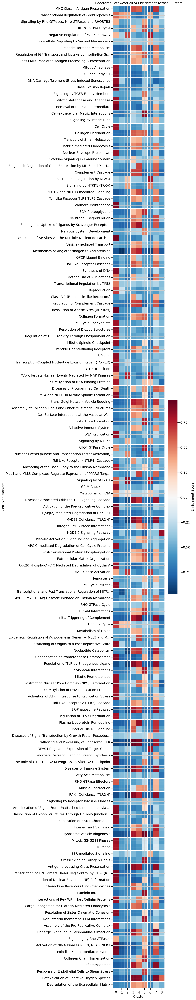

In [76]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

# Gene Set Collection
name = 'Reactome_Pathways_2024'
cleaned_named = name.replace("_", " ")

print(f"Loading {cleaned_named} gene sets...")
cellmarker_db = gp.get_library(name)

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets = gene_sets.drop_duplicates(subset=['geneset', 'genesymbol'])

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
# valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=50, max_pathways=150):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title(f'{cleaned_named} Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # # Save the plot
    # plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    # print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    # plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

# Gene Ontology Collections (GO)

## GO Biological Process 2025

Loading GO Biological Process 2025 gene sets...


0002 gene_sets have been filtered out when max_size=2000 and min_size=0


Using 5341 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Analysis complete!


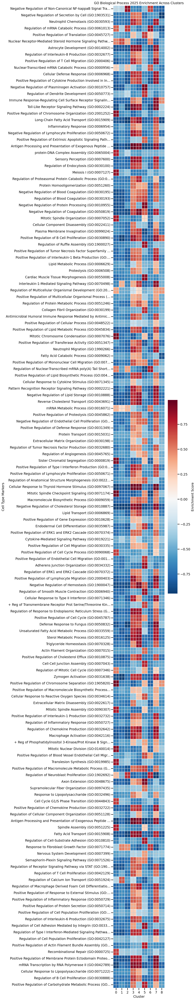

In [85]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

# Gene Set Collection
name = 'GO_Biological_Process_2025'
cleaned_named = name.replace("_", " ")

print(f"Loading {cleaned_named} gene sets...")
cellmarker_db = gp.get_library(name)

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets = gene_sets.drop_duplicates(subset=['geneset', 'genesymbol'])

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
# valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=50, max_pathways=150):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title(f'{cleaned_named} Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # # Save the plot
    # plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    # print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    # plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

## GO Cellular Component 2025

Loading GO Cellular Component 2025 gene sets...


0002 gene_sets have been filtered out when max_size=2000 and min_size=0


Using 466 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Analysis complete!


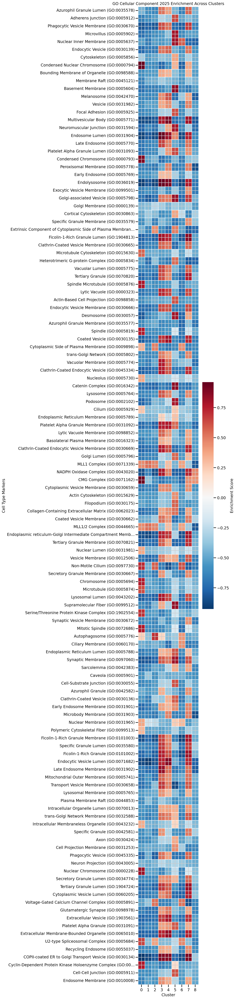

In [81]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

# Gene Set Collection
name = 'GO_Cellular_Component_2025'
cleaned_named = name.replace("_", " ")

print(f"Loading {cleaned_named} gene sets...")
cellmarker_db = gp.get_library(name)

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets = gene_sets.drop_duplicates(subset=['geneset', 'genesymbol'])

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
# valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=50, max_pathways=150):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title(f'{cleaned_named} Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # # Save the plot
    # plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    # print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    # plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

## GO Molecular Function 2025

Loading GO Molecular Function 2025 gene sets...


Using 1174 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Analysis complete!


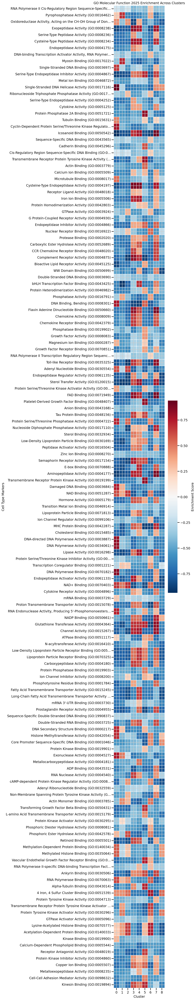

In [80]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

# Gene Set Collection
name = 'GO_Molecular_Function_2025'
cleaned_named = name.replace("_", " ")

print(f"Loading {cleaned_named} gene sets...")
cellmarker_db = gp.get_library(name)

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets = gene_sets.drop_duplicates(subset=['geneset', 'genesymbol'])

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
# valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=50, max_pathways=150):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title(f'{cleaned_named} Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # # Save the plot
    # plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    # print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    # plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

# Rummagene Signatures

Loading Rummagene signatures gene sets...


0395 gene_sets have been filtered out when max_size=2000 and min_size=0


Using 7288 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Analysis complete!


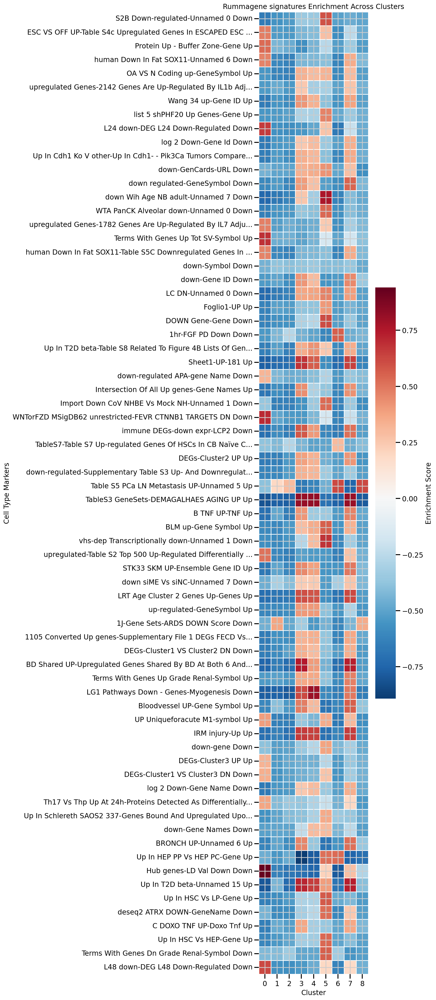

In [69]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

# Gene Set Collection
name = 'Rummagene_signatures'
cleaned_named = name.replace("_", " ")

print(f"Loading {cleaned_named} gene sets...")
cellmarker_db = gp.get_library(name)

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets['geneset'] = gene_sets['geneset'].str.split('xlsx-').str[1]

gene_sets = gene_sets.drop_duplicates(subset=['geneset', 'genesymbol'])

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
# valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=15, max_pathways=70):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title(f'{cleaned_named} Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # # Save the plot
    # plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    # print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    # plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

# Cell type signature

Processing cluster 0...
Processing cluster 1...
Processing cluster 2...
Processing cluster 3...
Processing cluster 4...
Processing cluster 5...
Processing cluster 6...
Processing cluster 7...
Processing cluster 8...
Processing cluster 9...
Processing cluster 10...
Processing cluster 11...
Processing cluster 12...
Processing cluster 13...
Processing cluster 14...
Processing cluster 15...


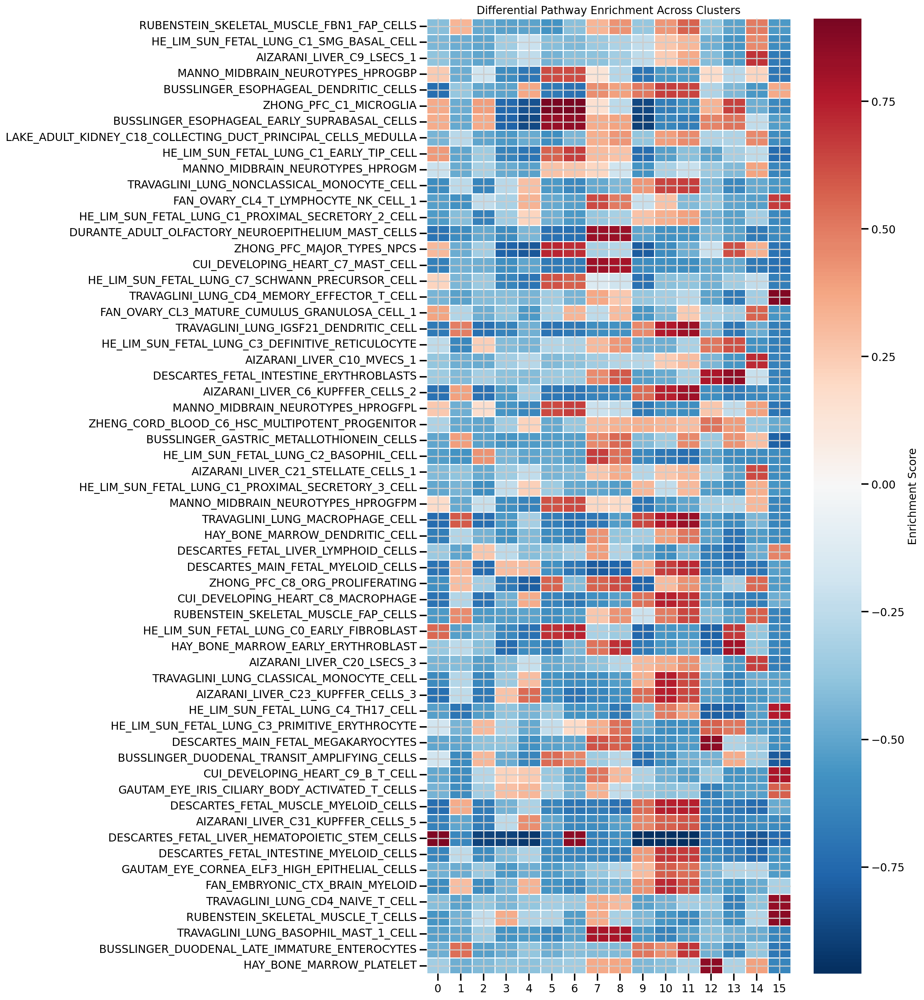

In [49]:
# 1. Get all cluster IDs
clusters = adata.obs['leiden'].cat.categories.tolist()

# 2. Run GSEA for each cluster and store results
all_gsea_results = {}

sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Retrieving via python
msigdb = decoupler.get_resource("MSigDB")

# Get reactome pathways
immune = msigdb.query("collection == 'cell_type_signatures'")

# Filter duplicates
immune = immune[~immune.duplicated(("geneset", "genesymbol"))]

# Filtering genesets to match behaviour of fgsea
geneset_size = immune.groupby("geneset").size()
gsea_genesets = geneset_size.index[(geneset_size > 15) & (geneset_size < 500)]

for cluster in clusters:
    print(f"Processing cluster {cluster}...")
    
    # Extract t-statistics for the current cluster
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        immune[immune["geneset"].isin(gsea_genesets)],
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    all_gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# 3. Create a heatmap to visualize pathway enrichment across clusters
def create_pathway_heatmap(all_results, top_n=20, max_pathways=60):
    """Create a heatmap of pathway enrichment across clusters"""
    
    # Get top pathways from each cluster
    top_pathways = set()
    for cluster, results in all_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to a reasonable number for visualization
    if len(top_pathways) > max_pathways:
        # Get the most significant paths
        all_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in all_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            all_pvals[pathway] = min_pval
        
        # Get top pathways
        top_pathways = sorted(all_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Create matrix of normalized enrichment scores
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = all_results[cluster]
            if pathway in results.index:
                norm_score = results.loc[pathway, 'score']
                row.append(norm_score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create a DataFrame for the heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=top_pathways, columns=clusters)
    
    # Plot the heatmap
    import matplotlib.pyplot as plt
    import seaborn as sns
    
    plt.figure(figsize=(16, len(top_pathways)*0.3))
    ax = sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    plt.title('Differential Pathway Enrichment Across Clusters')
    plt.tight_layout()
    plt.show()
    
    return heatmap_df

# Create the heatmap
pathway_enrichment_matrix = create_pathway_heatmap(all_gsea_results)

# Cellmarker 2024

Loading CellMarker 2024 gene sets...


Using 1126 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Heatmap saved as 'cellmarker_enrichment_heatmap.png'


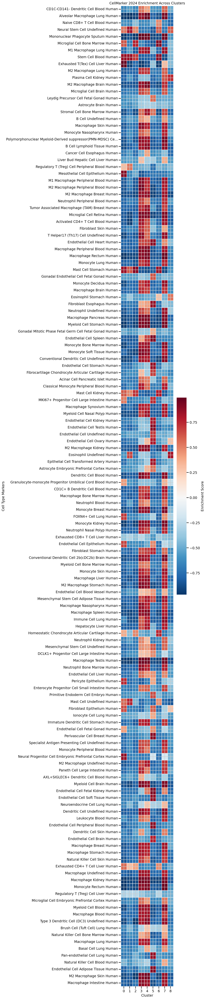

Analysis complete!


In [77]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

print("Loading CellMarker 2024 gene sets...")
cellmarker_db = gp.get_library('CellMarker_2024')

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

# Filter for human gene sets
gene_sets = gene_sets[gene_sets['geneset'].str.contains('Human')]

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=50, max_pathways=150):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title('CellMarker 2024 Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # Save the plot
    plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

# Azimuth 2023

Loading Azimuth 2023 gene sets...


Using 1425 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Analysis complete!


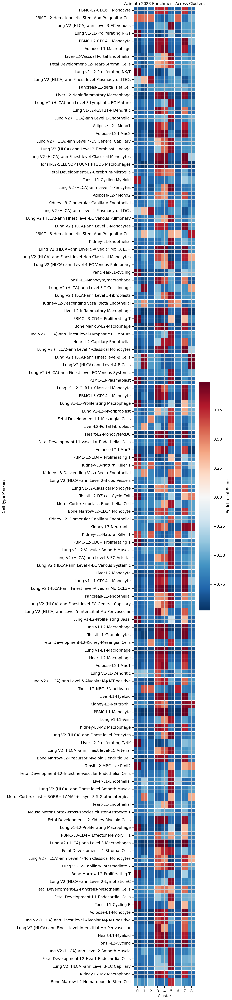

In [82]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

# Gene Set Collection
name = 'Azimuth_2023'
cleaned_named = name.replace("_", " ")

print(f"Loading {cleaned_named} gene sets...")
cellmarker_db = gp.get_library(name)

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets = gene_sets.drop_duplicates(subset=['geneset', 'genesymbol'])

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
# valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=50, max_pathways=150):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title(f'{cleaned_named} Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # # Save the plot
    # plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    # print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    # plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

# KEGG

Loading KEGG 2021 Human gene sets...


Using 320 gene sets
Computing differential expression...
Running GSEA for each cluster...
  Processing cluster 0...
  Processing cluster 1...
  Processing cluster 2...
  Processing cluster 3...
  Processing cluster 4...
  Processing cluster 5...
  Processing cluster 6...
  Processing cluster 7...
  Processing cluster 8...
Creating heatmap...
Analysis complete!


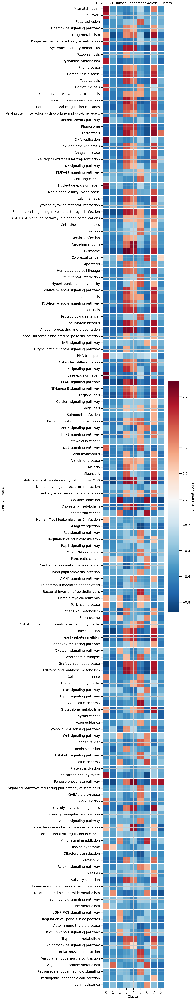

In [84]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler

# Load your data
adata = wk3_adata

# Gene Set Collection
name = 'KEGG_2021_Human'
cleaned_named = name.replace("_", " ")

print(f"Loading {cleaned_named} gene sets...")
cellmarker_db = gp.get_library(name)

# Convert to decoupler format
gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets = gene_sets.drop_duplicates(subset=['geneset', 'genesymbol'])

# Filter by gene set size (standard practice)
geneset_size = gene_sets.groupby("geneset").size()
# valid_genesets = geneset_size.index[(geneset_size >= 5) & (geneset_size <= 500)]
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

print(f"Using {gene_sets['geneset'].nunique()} gene sets")

# Get cluster information
clusters = adata.obs['leiden'].cat.categories.tolist()

# Compute differential expression
print("Computing differential expression...")
sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

# Run GSEA for each cluster
print("Running GSEA for each cluster...")
gsea_results = {}

for cluster in clusters:
    print(f"  Processing cluster {cluster}...")
    
    # Extract t-statistics
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        gene_sets,
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# Create heatmap
print("Creating heatmap...")

def create_gsea_heatmap(gsea_results, clusters, top_n=50, max_pathways=150):
    """Create heatmap of pathway enrichment across clusters"""
    
    # Collect top pathways from each cluster
    top_pathways = set()
    for cluster, results in gsea_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways for better visualization
    if len(top_pathways) > max_pathways:
        # Rank by best p-value across clusters
        pathway_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_pvals[pathway] = min_pval
        
        # Keep top pathways
        top_pathways = sorted(pathway_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better display
    def shorten_name(name, max_len=60):
        short = name.replace('Human_', '').replace('_', ' ')
        if len(short) > max_len:
            short = short[:max_len-3] + '...'
        return short
    
    shortened_names = [shorten_name(p) for p in top_pathways]
    
    # Build enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = gsea_results[cluster]
            if pathway in results.index:
                score = results.loc[pathway, 'score']
                row.append(score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=shortened_names, columns=clusters)
    
    plt.figure(figsize=(12, len(top_pathways) * 0.4))
    sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    
    plt.title(f'{cleaned_named} Enrichment Across Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Cell Type Markers')
    plt.tight_layout()
    
    # # Save the plot
    # plt.savefig('cellmarker_enrichment_heatmap.png', dpi=300, bbox_inches='tight')
    # print("Heatmap saved as 'cellmarker_enrichment_heatmap.png'")
    # plt.show()
    
    return heatmap_df

# Generate the heatmap
heatmap_df = create_gsea_heatmap(gsea_results, clusters)
print("Analysis complete!")

# PFOCR Pathways

Retrieving # PFOCR Pathways 2023 gene sets...


Retrieved 21845 GO BP terms with 272677 gene associations
After filtering by size: 21845 GO BP terms remain
Processing cluster 0...
Processing cluster 1...
Processing cluster 2...
Processing cluster 3...
Processing cluster 4...
Processing cluster 5...
Processing cluster 6...
Processing cluster 7...
Processing cluster 8...
Processing cluster 9...
Processing cluster 10...
Processing cluster 11...
Processing cluster 12...
Processing cluster 13...
Processing cluster 14...
Processing cluster 15...


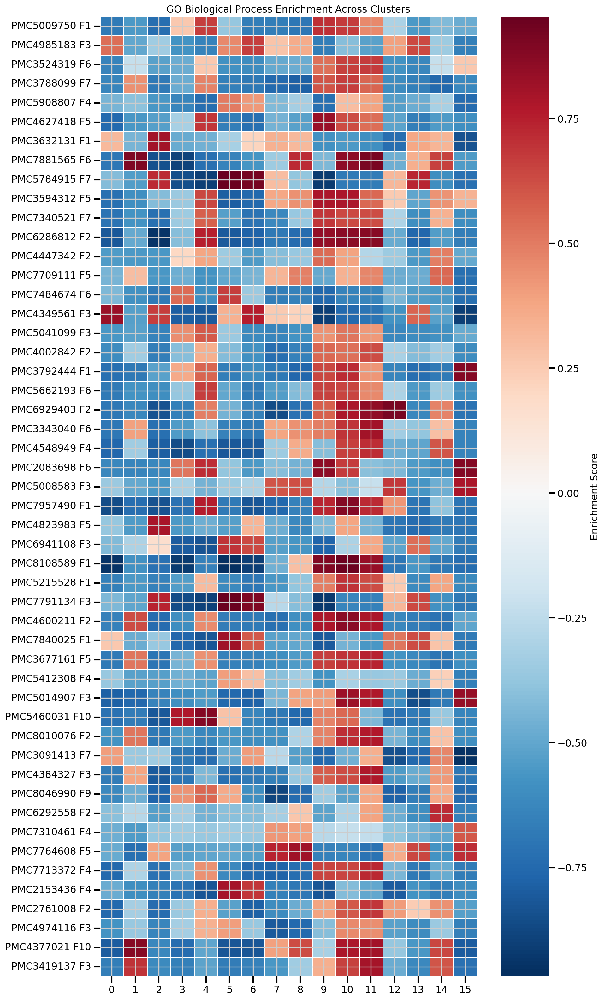

In [28]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

adata = wk2_adata

print("Retrieving # PFOCR Pathways 2023 gene sets...")
go_bp = gp.get_library('PFOCR_Pathways_2023')

# Convert to decoupler format
go_bp_decoupler = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in go_bp.items() 
    for gene in genes
])

print(f"Retrieved {go_bp_decoupler['geneset'].nunique()} GO BP terms with {go_bp_decoupler.shape[0]} gene associations")

# Filter gene sets by size
geneset_size = go_bp_decoupler.groupby("geneset").size()
# go_bp_filtered = geneset_size.index[(geneset_size > 15) & (geneset_size < 500)]
go_bp_filtered = geneset_size.index[(geneset_size > 0)]
print(f"After filtering by size: {len(go_bp_filtered)} GO BP terms remain")

# 1. Get all cluster IDs
clusters = adata.obs['leiden'].cat.categories.tolist()

# 2. Run GSEA for each cluster and store results
all_gsea_results = {}

sc.tl.rank_genes_groups(adata, "leiden", method="t-test", key_added="t-test")

for cluster in clusters:
    print(f"Processing cluster {cluster}...")
    
    # Extract t-statistics for the current cluster
    t_stats = (
        sc.get.rank_genes_groups_df(adata, cluster, key='t-test')
        .set_index("names")
        .loc[adata.var["highly_variable"]]
        .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
        .rename_axis([cluster], axis=1)
    )
    
    # Run GSEA with GO BP instead of reactome
    scores, norm, pvals = decoupler.run_gsea(
        t_stats.T,
        go_bp_decoupler[go_bp_decoupler["geneset"].isin(go_bp_filtered)],
        source="geneset",
        target="genesymbol",
    )
    
    # Store results
    all_gsea_results[cluster] = (
        pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
        .droplevel(level=1, axis=1)
        .sort_values("pval")
    )

# 3. Create a heatmap to visualize GO BP enrichment across clusters
def create_pathway_heatmap(all_results, top_n=15, max_pathways=50):
    """Create a heatmap of GO BP enrichment across clusters"""
    
    # Get top pathways from each cluster
    top_pathways = set()
    for cluster, results in all_results.items():
        top_cluster_pathways = results.head(top_n).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to a reasonable number for visualization
    if len(top_pathways) > max_pathways:
        # Get the most significant paths
        all_pvals = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in all_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            all_pvals[pathway] = min_pval
        
        # Get top pathways
        top_pathways = sorted(all_pvals.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    
    # Shorten pathway names for better visualization
    shortened_pathways = {}
    for path in top_pathways:
        # Remove 'GO_' prefix and truncate if too long
        short_name = path.replace('GO_', '')
        if len(short_name) > 60:
            short_name = short_name[:57] + '...'
        shortened_pathways[path] = short_name
    
    # Create matrix of normalized enrichment scores
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = all_results[cluster]
            if pathway in results.index:
                norm_score = results.loc[pathway, 'score']
                row.append(norm_score)
            else:
                row.append(0)
        heatmap_data.append(row)
    
    # Create a DataFrame for the heatmap
    heatmap_df = pd.DataFrame(heatmap_data, index=[shortened_pathways[p] for p in top_pathways], columns=clusters)
    
    # Plot the heatmap
    plt.figure(figsize=(12, len(top_pathways)*0.4))  # Adjust height for GO terms
    ax = sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=.5,
        yticklabels=True,
        cbar_kws={'label': 'Enrichment Score'}
    )
    plt.title('GO Biological Process Enrichment Across Clusters')
    plt.tight_layout()
    plt.savefig('go_bp_enrichment_heatmap.png', dpi=300, bbox_inches='tight')  # Save high-res image
    plt.show()
    
    return heatmap_df
+
# Create the heatmap
pathway_enrichment_matrix = create_pathway_heatmap(all_gsea_results)

# Function

In [47]:
import gseapy as gp
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import decoupler
from typing import Optional, Union, Dict, Any

def create_pathway_enrichment_heatmap(
    adata,
    collection_name: str,
    max_pathways: int = 50,
    top_n_per_cluster: int = 15,
    min_geneset_size: int = 5,
    max_geneset_size: int = 500,
    clustering_key: str = "leiden",
    use_highly_variable: bool = True,
    method: str = "t-test",
    figsize: tuple = (12, 10),
    save_path: Optional[str] = None,
    return_results: bool = False
) -> Union[pd.DataFrame, tuple]:
    """
    Create a pathway enrichment heatmap across clusters using GSEA.
    
    This function follows single-cell best practices for pathway enrichment analysis:
    1. Performs differential gene expression testing per cluster
    2. Runs Gene Set Enrichment Analysis (GSEA) using ranked gene lists
    3. Filters gene sets by appropriate size thresholds
    4. Creates a heatmap visualization of enrichment scores
    
    Parameters
    ----------
    adata : AnnData
        Annotated data object with clustering results
    collection_name : str
        Name of the Enrichr gene set collection (e.g., 'GO_Biological_Process_2021', 
        'KEGG_2021_Human', 'Reactome_2022')
    max_pathways : int, default 50
        Maximum number of pathways to display in heatmap
    top_n_per_cluster : int, default 15
        Number of top pathways to consider from each cluster
    min_geneset_size : int, default 5
        Minimum number of genes required in a gene set
    max_geneset_size : int, default 500
        Maximum number of genes allowed in a gene set
    clustering_key : str, default "leiden"
        Key in adata.obs containing cluster assignments
    use_highly_variable : bool, default True
        Whether to restrict analysis to highly variable genes
    method : str, default "t-test"
        Method for differential expression testing
    figsize : tuple, default (12, 10)
        Figure size for the heatmap
    save_path : str, optional
        Path to save the heatmap figure
    return_results : bool, default False
        Whether to return detailed GSEA results
        
    Returns
    -------
    pd.DataFrame or tuple
        If return_results=False: DataFrame with pathway enrichment matrix
        If return_results=True: Tuple of (enrichment_matrix, detailed_gsea_results)
        
    Notes
    -----
    This function implements competitive gene set testing using GSEA, which tests
    whether genes in a set are highly ranked relative to genes not in the set.
    The enrichment scores are signed, with positive scores indicating upregulation
    and negative scores indicating downregulation of the pathway.
    
    Examples
    --------
    >>> # Basic usage with GO Biological Process
    >>> heatmap_df = create_pathway_enrichment_heatmap(
    ...     adata, 
    ...     'GO_Biological_Process_2021',
    ...     max_pathways=30
    ... )
    
    >>> # With KEGG pathways and custom parameters
    >>> heatmap_df = create_pathway_enrichment_heatmap(
    ...     adata,
    ...     'KEGG_2021_Human',
    ...     max_pathways=40,
    ...     top_n_per_cluster=20,
    ...     save_path='kegg_enrichment.png'
    ... )
    """
    
    print(f"Starting pathway enrichment analysis with {collection_name}...")
    
    # 1. Retrieve gene sets from Enrichr
    print(f"Retrieving {collection_name} gene sets...")
    try:
        gene_sets = gp.get_library(collection_name)
    except Exception as e:
        raise ValueError(f"Failed to retrieve {collection_name}. Available collections can be found with gseapy.get_library_name()")
    
    # Convert to decoupler format
    gene_sets_decoupler = pd.DataFrame([
        {'geneset': term, 'genesymbol': gene} 
        for term, genes in gene_sets.items() 
        for gene in genes
    ])
    
    print(f"Retrieved {gene_sets_decoupler['geneset'].nunique()} terms with {gene_sets_decoupler.shape[0]} gene associations")
    
    # 2. Filter gene sets by size (following best practices)
    geneset_size = gene_sets_decoupler.groupby("geneset").size()
    filtered_genesets = geneset_size.index[
        (geneset_size >= min_geneset_size) & (geneset_size <= max_geneset_size)
    ]
    gene_sets_filtered = gene_sets_decoupler[
        gene_sets_decoupler["geneset"].isin(filtered_genesets)
    ]
    
    print(f"After filtering by size ({min_geneset_size}-{max_geneset_size} genes): {len(filtered_genesets)} terms remain")
    
    # 3. Get cluster information
    if clustering_key not in adata.obs.columns:
        raise ValueError(f"Clustering key '{clustering_key}' not found in adata.obs")
    
    clusters = adata.obs[clustering_key].cat.categories.tolist()
    print(f"Analyzing {len(clusters)} clusters: {clusters}")
    
    # 4. Perform differential expression testing
    print(f"Computing differential expression using {method}...")
    sc.tl.rank_genes_groups(adata, clustering_key, method=method, key_added=method)
    
    # 5. Run GSEA for each cluster
    all_gsea_results = {}
    
    for cluster in clusters:
        print(f"Processing cluster {cluster}...")
        
        # Extract test statistics for the current cluster
        de_results = sc.get.rank_genes_groups_df(adata, cluster, key=method)
        
        # Filter to highly variable genes if requested
        if use_highly_variable:
            if "highly_variable" not in adata.var.columns:
                print("Warning: highly_variable not found, using all genes")
                gene_filter = adata.var.index
            else:
                gene_filter = adata.var[adata.var["highly_variable"]].index
        else:
            gene_filter = adata.var.index
        
        # Prepare ranked gene list for GSEA
        t_stats = (
            de_results
            .set_index("names")
            .loc[gene_filter]
            .sort_values("scores", key=np.abs, ascending=False)[["scores"]]
            .rename_axis([cluster], axis=1)
        )
        
        # Run GSEA using decoupler
        try:
            scores, norm, pvals = decoupler.run_gsea(
                t_stats.T,
                gene_sets_filtered,
                source="geneset",
                target="genesymbol",
            )
            
            # Store results
            all_gsea_results[cluster] = (
                pd.concat({"score": scores.T, "norm": norm.T, "pval": pvals.T}, axis=1)
                .droplevel(level=1, axis=1)
                .sort_values("pval")
            )
        except Exception as e:
            print(f"Warning: GSEA failed for cluster {cluster}: {e}")
            continue
    
    if not all_gsea_results:
        raise RuntimeError("GSEA failed for all clusters")
    
    # 6. Create pathway heatmap
    print("Creating pathway enrichment heatmap...")
    
    # Get top pathways from each cluster
    top_pathways = set()
    for cluster, results in all_gsea_results.items():
        top_cluster_pathways = results.head(top_n_per_cluster).index.tolist()
        top_pathways.update(top_cluster_pathways)
    
    # Limit to max_pathways based on overall significance
    if len(top_pathways) > max_pathways:
        print(f"Limiting to top {max_pathways} most significant pathways...")
        
        # Calculate minimum p-value across clusters for each pathway
        pathway_significance = {}
        for pathway in top_pathways:
            min_pval = 1.0
            for cluster, results in all_gsea_results.items():
                if pathway in results.index:
                    min_pval = min(min_pval, results.loc[pathway, 'pval'])
            pathway_significance[pathway] = min_pval
        
        # Select top pathways by significance
        top_pathways = sorted(pathway_significance.items(), key=lambda x: x[1])[:max_pathways]
        top_pathways = [p[0] for p in top_pathways]
    else:
        top_pathways = list(top_pathways)
    
    # Shorten pathway names for visualization
    def shorten_pathway_name(pathway_name: str, max_length: int = 60) -> str:
        """Shorten pathway names for better visualization"""
        # Remove common prefixes
        name = pathway_name.replace('GO_', '').replace('KEGG_', '').replace('REACTOME_', '')
        # Replace underscores with spaces
        name = name.replace('_', ' ').title()
        # Truncate if too long
        if len(name) > max_length:
            name = name[:max_length-3] + '...'
        return name
    
    shortened_names = {path: shorten_pathway_name(path) for path in top_pathways}

    shortened_names = shortened_names[shortened_names['geneset'].str.contains('Human')]
    
    # Create enrichment matrix
    heatmap_data = []
    for pathway in top_pathways:
        row = []
        for cluster in clusters:
            results = all_gsea_results[cluster]
            if pathway in results.index:
                enrichment_score = results.loc[pathway, 'score']
                row.append(enrichment_score)
            else:
                row.append(0)  # No enrichment if pathway not significant
        heatmap_data.append(row)
    
    # Create DataFrame for heatmap
    heatmap_df = pd.DataFrame(
        heatmap_data, 
        index=[shortened_names[p] for p in top_pathways], 
        columns=clusters
    )
    
    # 7. Plot heatmap
    plt.figure(figsize=figsize)
    
    # Calculate appropriate font sizes based on number of pathways
    yticklabel_size = max(6, min(10, 200 // len(top_pathways)))
    
    ax = sns.heatmap(
        heatmap_df, 
        cmap="RdBu_r",
        center=0,
        annot=False,
        linewidths=0.5,
        yticklabels=True,
        xticklabels=True,
        cbar_kws={'label': 'Enrichment Score', 'shrink': 0.8}
    )
    
    # Customize plot
    plt.title(f'{collection_name.replace("_", " ")} Enrichment Across Clusters', 
              fontsize=14, fontweight='bold', pad=20)
    plt.xlabel('Cluster', fontsize=12, fontweight='bold')
    plt.ylabel('Pathway', fontsize=12, fontweight='bold')
    
    # Adjust tick label sizes
    ax.tick_params(axis='y', labelsize=yticklabel_size)
    ax.tick_params(axis='x', labelsize=10)
    
    # Rotate y-axis labels for better readability
    plt.yticks(rotation=0)
    plt.xticks(rotation=45)
    
    plt.tight_layout()
    
    # Save if requested
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight', facecolor='white')
        print(f"Heatmap saved to {save_path}")
    
    plt.show()
    
    print(f"Analysis complete! Displayed {len(top_pathways)} pathways across {len(clusters)} clusters.")
    
    # Return results
    if return_results:
        return heatmap_df, all_gsea_results
    else:
        return heatmap_df

Starting pathway enrichment analysis with CellMarker_2024...
Retrieving CellMarker_2024 gene sets...


Retrieved 1692 terms with 50496 gene associations
After filtering by size (5-500 genes): 1677 terms remain
Analyzing 16 clusters: ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15']
Computing differential expression using t-test...
Processing cluster 0...
Processing cluster 1...
Processing cluster 2...
Processing cluster 3...
Processing cluster 4...
Processing cluster 5...
Processing cluster 6...
Processing cluster 7...
Processing cluster 8...
Processing cluster 9...
Processing cluster 10...
Processing cluster 11...
Processing cluster 12...
Processing cluster 13...
Processing cluster 14...
Processing cluster 15...
Creating pathway enrichment heatmap...
Limiting to top 50 most significant pathways...


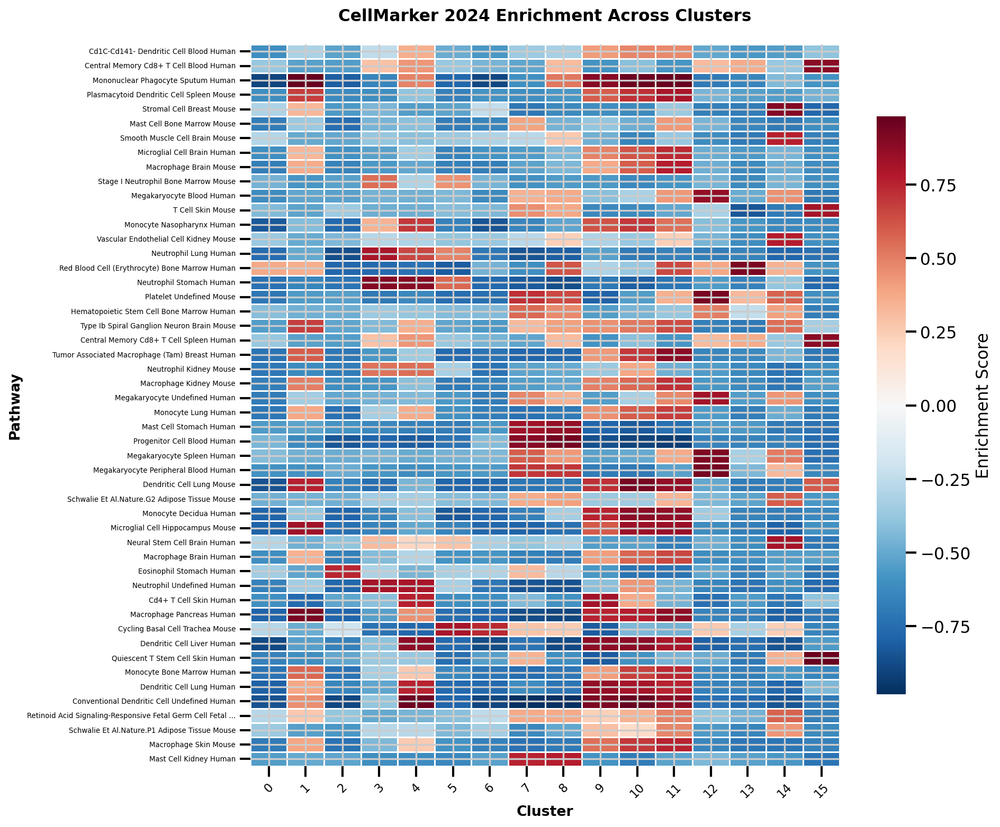

Analysis complete! Displayed 50 pathways across 16 clusters.


In [48]:
# Get detailed results too
heatmap_df, detailed_results = create_pathway_enrichment_heatmap(
    adata,
    'CellMarker_2024',
    return_results=True,
    max_pathways=50
)

In [49]:
detailed_results

{'0':                                                       score      norm  \
 source                                                                  
 CD1C-CD141- Dendritic Cell Blood Human            -0.605957 -1.792590   
 Microglial Cell Hippocampus Mouse                 -0.791240 -1.839959   
 Microglial Cell Embryonic Prefrontal Cortex Human -0.587551 -1.806095   
 Microglial Cell Brain Human                       -0.609756 -1.836074   
 Macrophage Synovium Human                         -0.801273 -1.759666   
 ...                                                     ...       ...   
 Quiescent Neural Stem Cell Brain Mouse             0.229665  0.518412   
 Pericyte Lung Mouse                               -0.240255 -0.505793   
 Germinal Center B Cell Nasopharynx Human          -0.267596 -0.524563   
 Myofibroblast Lung Mouse                          -0.196910 -0.475808   
 Immune Cell Undefined Human                       -0.233172 -0.451997   
 
                               

# Misc.

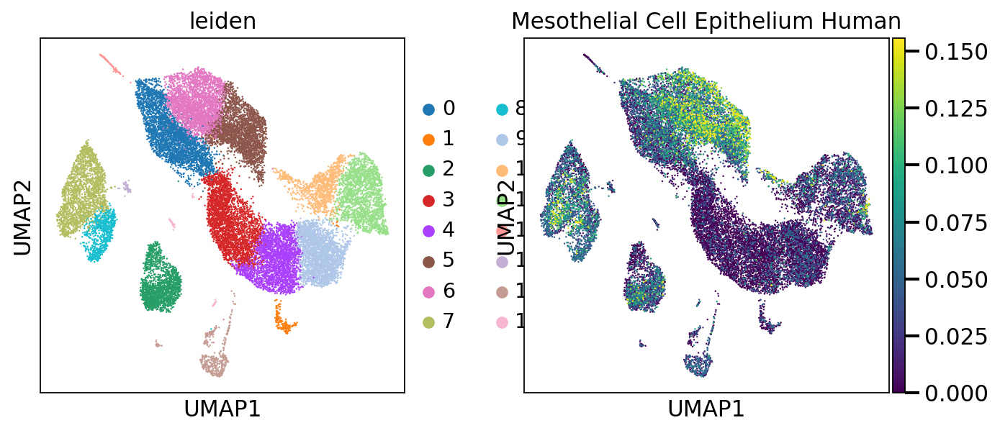

In [4]:
cellmarker_db = gp.get_library('CellMarker_2024')

gene_sets = pd.DataFrame([
    {'geneset': term, 'genesymbol': gene} 
    for term, genes in cellmarker_db.items() 
    for gene in genes
])

gene_sets = gene_sets[gene_sets['geneset'].str.contains('Human')]

geneset_size = gene_sets.groupby("geneset").size()
valid_genesets = geneset_size.index[(geneset_size >= 5)]
gene_sets = gene_sets[gene_sets["geneset"].isin(valid_genesets)]

decoupler.run_aucell(
    wk2_adata,
    gene_sets,
    source="geneset",
    target="genesymbol",
    use_raw=False,
)

wk2_adata.obs = pd.concat([wk2_adata.obs, wk2_adata.obsm["aucell_estimate"]], axis=1)

sc.pl.umap(wk2_adata, color=["leiden", "Exhausted T(Tex) Cell Liver Human"], vmax='p99')

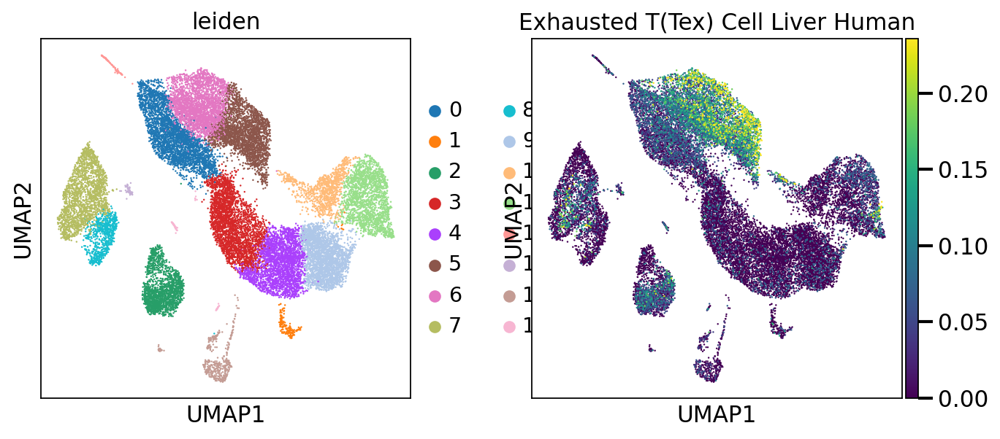

In [5]:
sc.pl.umap(wk2_adata, color=["leiden", "Exhausted T(Tex) Cell Liver Human"], vmax='p99')

# GSEApy

In [2]:
import gseapy as gp
from gseapy import Msigdb
import pandas as pd
import numpy as np
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

msig = Msigdb()

adata = wk2_adata.copy()

# Get MSigDB C8 (cell type signatures) collection
print("Loading MSigDB C8 cell type signatures...")
c8_signatures = msig.get_gmt(category='c8.all')
print(f"Loaded {len(c8_signatures)} cell type signatures")

# Preview some signatures
print("\nExample cell type signatures:")
for i, (celltype, genes) in enumerate(list(c8_signatures.items())[:5]):
    print(f"{celltype}: {len(genes)} genes")

# Extract top marker genes for each cluster
n_genes = 200  # Number of top genes to use for enrichment
cluster_markers = {}

for cluster in adata.obs[clustering_key].unique():
    # Get marker genes for this cluster
    markers_df = sc.get.rank_genes_groups_df(adata, group=str(cluster))
    
    # Filter for significant and upregulated genes
    sig_markers = markers_df[
        (markers_df['pvals_adj'] < 0.05) & 
        (markers_df['logfoldchanges'] > 0)
    ]
    
    # Take top N genes
    top_markers = sig_markers.nsmallest(n_genes, 'pvals_adj')['names'].tolist()
    cluster_markers[str(cluster)] = top_markers
    
    print(f"Cluster {cluster}: {len(top_markers)} marker genes")

# Run enrichment analysis for each cluster
enrichment_results = {}

for cluster, marker_genes in cluster_markers.items():
    if len(marker_genes) > 0:  # Only run if we have marker genes
        print(f"\nAnalyzing cluster {cluster}...")
        
        # Run enrichment analysis
        enr = gp.enrichr(
            gene_list=marker_genes,
            gene_sets=c8_signatures,
            organism='Human',
            outdir=None,  # Set to a path if you want to save results
            no_plot=True,
            cutoff=0.05
        )
        
        # Store results
        enrichment_results[cluster] = enr.results
        
        # Print top 3 cell types
        print(f"Top cell types for cluster {cluster}:")
        top_results = enr.results.nsmallest(3, 'Adjusted P-value')
        for idx, row in top_results.iterrows():
            print(f"  {row['Term']}: p-adj = {row['Adjusted P-value']:.3e}, "
                  f"Overlap = {row['Overlap']}")

# Create a heatmap of enrichment scores across clusters
# Collect top cell types across all clusters
all_top_celltypes = set()
n_top = 3  # Number of top cell types per cluster

for cluster, results in enrichment_results.items():
    if len(results) > 0:
        top_ct = results.nsmallest(n_top, 'Adjusted P-value')['Term'].tolist()
        all_top_celltypes.update(top_ct)

# Create matrix of -log10(adjusted p-values)
celltype_matrix = pd.DataFrame(index=list(all_top_celltypes), 
                              columns=sorted(enrichment_results.keys(), key=int))

for cluster, results in enrichment_results.items():
    for celltype in all_top_celltypes:
        if celltype in results['Term'].values:
            pval = results[results['Term'] == celltype]['Adjusted P-value'].values[0]
            celltype_matrix.loc[celltype, cluster] = -np.log10(pval + 1e-20)
        else:
            celltype_matrix.loc[celltype, cluster] = 0

# Convert to numeric
celltype_matrix = celltype_matrix.astype(float)

# Plot heatmap
plt.figure(figsize=(20, max(8, len(all_top_celltypes) * 0.3)))
sns.heatmap(celltype_matrix, 
            cmap='Reds',
            cbar_kws={'label': '-log10(adjusted p-value)'},
            xticklabels=True,
            yticklabels=True,
            linewidths=0.5)
plt.title('Cell Type Enrichment Across Clusters')
plt.xlabel('Cluster')
plt.ylabel('Cell Type Signature')
plt.tight_layout()
plt.show()

Loading MSigDB C8 cell type signatures...
Loaded 830 cell type signatures

Example cell type signatures:
BUSSLINGER_ESOPHAGEAL_QUIESCENT_BASAL_CELLS: 77 genes
BUSSLINGER_ESOPHAGEAL_PROLIFERATING_BASAL_CELLS: 70 genes
BUSSLINGER_ESOPHAGEAL_EARLY_SUPRABASAL_CELLS: 79 genes
BUSSLINGER_ESOPHAGEAL_LATE_SUPRABASAL_CELLS: 140 genes
BUSSLINGER_ESOPHAGEAL_DENDRITIC_CELLS: 214 genes


NameError: name 'clustering_key' is not defined